# Clustering HeteroPolymers

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

c:\Users\ashis\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
c:\Users\ashis\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
c:\Users\ashis\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
import Algorithms.ALG as ALG                   # importing algorithms
import Metrics.GROUND_METRICS as MC_1          # importing lib with Ground metrics - Only for Experimental benchmarking
import Metrics.STANDALONE_METRICS as MC_2      # importing lib with standalone metrics

import Worker.INITIAL_PLOTTER as IPLOT         # Initial Sample plotter
import Worker.FINAL_PLOTTER as FPLOT           # Cluster Sample & result Plotter 

import Worker.DATA_READER as DR                # Data Reader i.e. Path of the scan data

import Worker.MODS as DM                       # Data Operations to be performed 

#### Reading the  AFM Scan  Data

In [3]:
data, original = DR.reader("W:\\Data PYTHON\\SET_2\\COMBINED") # The path of the AFM scan data is entered here

# Data = reshaped data for clustering
# original = AFM scan data in image matrixformat 

#### Data operations 

In [4]:
# Performs 1D & 2D Fourier Transform on the Data


# One Dimensional Fourier Transform (INPUT = Original Part from reader())
# Output = Two elements (Columns) (Rows), We are using ROWS for clustering 

ONE_Data = DM.Process_1D_F(original) #ROW WISE

# Two Dimensional Fourier Transform (INPUT = Original Part from reader())
# Output = One elements Transformed Data of AFM scan in 2D Fourier format

TWO_Data = DM.Process_2D_F(original)

------------

#### Performing Clustering using the various algorithms for three types of data:

        Data 1. RAW AFM data
        Data 2. ONE Dimensional Fourier Transformed Data
        Data 3. TWO Dimensional Fourier Transfomred Data

At this stage of the tool, the aim was to benchmark the algorithms, hence, the algorithms was split into two main groups:

        Group 1. Automated Clustering (These are algorithms that automatically perform clustering via internal calculations)
        Group 2. Parameteric Clustering (These are algorithms that require additional tuning to obtain proper results)



#### The Naming of the Variables is as follows:

    T_ = Type of Data (RAW, ONE D, TWO D) [1,2,3]
    A_ = Algorithm Number [1,13]
    G_ = Groups of Algorithms [1,2]

-----------

#### Data 1: RAW AFM Data

##### Group 1

In [5]:
T1_A1_G1 = ALG.K_MEANS(data, 3) 
T1_A2_G1 = ALG.K_MEANS_PLUS(data, 3)
T1_A3_G1 = ALG.K_MEANS_BISECT(data, 3)
T1_A7_G1 = ALG.HIERARCHY(data, 3, 0)
T1_A8_G1 = ALG.FUZZY_C(data, 3)
T1_A11_G1 = ALG.BIRCH(data, 3)
T1_A13_G1 = ALG.SPECTRAL(data, 3)

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

#### Group 2

In [123]:
T1_A4_G2 = ALG.DBSCAN_AUTO(data, 2,2) # IDEAL 2,3 = 4 clusters
T1_A9_G2 = ALG.MEAN_SHIFT(data,0.00018) # <0.00017 = 3+ clusters & >18 = 2 clusters or lesser
T1_A10_G2 = ALG.AFFINITY(data,0.974)
T1_A5_G2 = ALG.DBSCAN_MANUAL(data,0.000189,3)     #DBSCAN MANUAL
T1_A6_G2 = ALG.HDBSCAN_MANUAL(data,6, 3, 500) #HDBSCAN_MANUAL
T1_A12_G2 = ALG.OPTICS_AUTO(data, 3)        #OPTICS AUTO

---------------

#### Data 2: ONE Dimensional Fourier Transform

#### Group 1

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

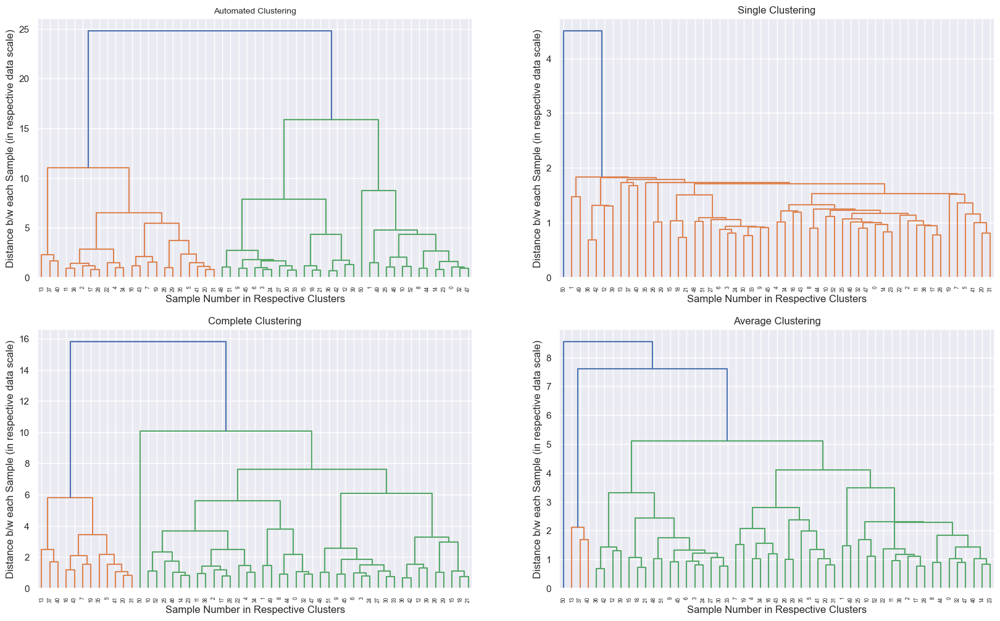

In [124]:
T2_A1_G1 = ALG.K_MEANS(ONE_Data[1], 3) 
T2_A2_G1 = ALG.K_MEANS_PLUS(ONE_Data[1], 3)
T2_A3_G1 = ALG.K_MEANS_BISECT(ONE_Data[1], 3)
T2_A7_G1 = ALG.HIERARCHY(ONE_Data[1], 3, 1)
T2_A8_G1 = ALG.FUZZY_C(ONE_Data[1], 3)
T2_A11_G1 = ALG.BIRCH(ONE_Data[1], 3)
T2_A13_G1 = ALG.SPECTRAL(ONE_Data[1], 3)

#### Group 2

In [247]:
T2_A4_G2 = ALG.DBSCAN_AUTO(ONE_Data[1], 2,3)
T2_A9_G2 = ALG.MEAN_SHIFT(ONE_Data[1], 2.9)
T2_A10_G2 = ALG.AFFINITY(ONE_Data[1], 0.850)

T2_A5_G2 = ALG.DBSCAN_MANUAL(ONE_Data[1], 1.7, 3)
T2_A6_G2 = ALG.HDBSCAN_MANUAL(ONE_Data[1], 6, 3, 500) 
T2_A12_G2 = ALG.OPTICS_AUTO(ONE_Data[1], 12) 

----------

#### Data 3: TWO Dimensional Fourier Transform

#### Group 1

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

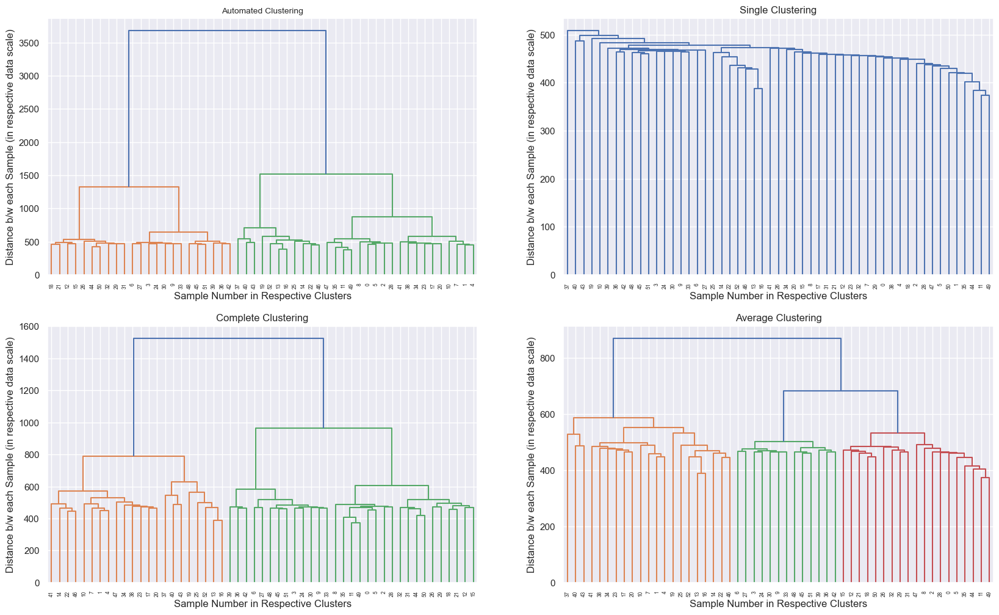

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


In [248]:
T3_A1_G1 = ALG.K_MEANS(TWO_Data, 3) 
T3_A2_G1 = ALG.K_MEANS_PLUS(TWO_Data, 3)
T3_A3_G1 = ALG.K_MEANS_BISECT(TWO_Data, 3)
T3_A7_G1 = ALG.HIERARCHY(TWO_Data, 3,1)
T3_A8_G1 = ALG.FUZZY_C(TWO_Data, 3)
T3_A11_G1 = ALG.BIRCH(TWO_Data, 3)
T3_A13_G1 = ALG.SPECTRAL(TWO_Data, 3)

#### Group 2

In [302]:
T3_A4_G2 = ALG.DBSCAN_AUTO(TWO_Data, 2, 2)
T3_A9_G2 = ALG.MEAN_SHIFT(TWO_Data, 488)
T3_A10_G2 = ALG.AFFINITY(TWO_Data, 0.91)

T3_A5_G2 = ALG.DBSCAN_MANUAL(TWO_Data,472,5)
T3_A6_G2 = ALG.HDBSCAN_MANUAL(TWO_Data,6,4,470)
T3_A12_G2 = ALG.OPTICS_AUTO(TWO_Data, 3)

-----------

#### Creation of Ground truth to Verify the execution of the Metrics

##### Establishing Ground truth

In [303]:
# cluster # = Size
# 0 = 5μm
# 1 = 10μm
# 2 = 30μm
GD = np.array([1, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0,
               1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 
               0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0])
               

## Evaluation of the Results

    1. Ground Truth Metrics:
        1. Rand Index
        2. Adj Rand Index 
        3. MMI
        4. Homogeneity 
        5. Completness
        6. V Measure
        7. Geometric Mean 

    2. Non Ground Truth Metrics:
        1. Silhouette_Score
        2. Calinski_Harabasz_Score
        3. Davies_Bouldin_Score

----------

#### Evaluating Metrics for Data Type 1 (RAW Data)

In [304]:
T1_A1_G1_M1 =  MC_1.Metric_1(GD, T1_A1_G1[1],"K MEANS")
T1_A2_G1_M1 =  MC_1.Metric_1(GD, T1_A2_G1[1],"K MEANS++")
T1_A3_G1_M1 =  MC_1.Metric_1(GD, T1_A3_G1[1],"K MEANS BISECT")
T1_A7_G1_M1 =  MC_1.Metric_1(GD, T1_A7_G1[1],"HIERARCHY")
T1_A8_G1_M1 =  MC_1.Metric_1(GD, T1_A8_G1[1],"FUZZY_C")
T1_A11_G1_M1 =  MC_1.Metric_1(GD, T1_A11_G1[1],"BIRCH")
T1_A13_G1_M1 =  MC_1.Metric_1(GD, T1_A13_G1[1],"SPECTRAL")

T1_A4_G2_M1 =  MC_1.Metric_1(GD, T1_A4_G2[1],"DBSCAN AUTO")
T1_A9_G2_M1 =  MC_1.Metric_1(GD, T1_A9_G2[1],"MEAN SHIFT")
T1_A10_G2_M1 =  MC_1.Metric_1(GD, T1_A10_G2[1],"AFFINITY")

T1_A5_G2_M1 =  MC_1.Metric_1(GD, T1_A5_G2[1],"DBSCAN MANUAL")
T1_A6_G2_M1 =  MC_1.Metric_1(GD, T1_A6_G2[1],"HDBSCAN MANUAL")
T1_A12_G2_M1 =  MC_1.Metric_1(GD, T1_A12_G2[1],"OPTICS AUTO")


T1_Final_1_M1 = pd.concat([T1_A1_G1_M1[1], T1_A2_G1_M1[1], T1_A3_G1_M1[1], T1_A7_G1_M1[1], T1_A8_G1_M1[1], T1_A11_G1_M1[1], T1_A13_G1_M1[1]])
T1_Final_2_M1 = pd.concat([T1_A4_G2_M1[1], T1_A9_G2_M1[1], T1_A10_G2_M1[1]])
T1_Final_3_M1 = pd.concat([T1_A5_G2_M1[1], T1_A6_G2_M1[1], T1_A12_G2_M1[1]]) 

DA_A_G = pd.concat([T1_Final_1_M1,T1_Final_2_M1,T1_Final_3_M1])
DA_A_G.columns = pd.MultiIndex.from_product([[" Ground Truth Metrics "], DA_A_G.columns])
DA_A_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using AFM Height Data via Ground Truth Metrics')



In [305]:
T1_A1_G1_M2 =  MC_2.Metric_2(data, T1_A1_G1[1],"K MEANS")
T1_A2_G1_M2 =  MC_2.Metric_2(data, T1_A2_G1[1],"K MEANS++")
T1_A3_G1_M2 =  MC_2.Metric_2(data, T1_A3_G1[1],"K MEANS BISECT")
T1_A7_G1_M2 =  MC_2.Metric_2(data, T1_A7_G1[1],"HIERARCHY")
T1_A8_G1_M2 =  MC_2.Metric_2(data, T1_A8_G1[1],"FUZZY_C")
#T1_A11_G1_M2 =  MC_2.Metric_2(data, T1_A11_G1[1],"BIRCH")
T1_A13_G1_M2 =  MC_2.Metric_2(data, T1_A13_G1[1],"SPECTRAL")

T1_A4_G2_M2 =  MC_2.Metric_2(data, T1_A4_G2[1],"DBSCAN AUTO")
T1_A9_G2_M2 =  MC_2.Metric_2(data, T1_A9_G2[1],"MEAN SHIFT")
#T1_A10_G2_M2 =  MC_2.Metric_2(data, T1_A10_G2[1],"AFFINITY") 
T1_A5_G2_M2 =  MC_2.Metric_2(data, T1_A5_G2[1],"DBSCAN MANUAL")
#T1_A6_G2_M2 =  MC_2.Metric_2(data, (T1_A6_G2[1]+1),"HDBSCAN MANUAL")
T1_A12_G2_M2 =  MC_2.Metric_2(data, T1_A12_G2[1],"OPTICS AUTO")


T1_Final_1_M2 = pd.concat([T1_A1_G1_M2[1], T1_A2_G1_M2[1], T1_A3_G1_M2[1], T1_A7_G1_M2[1], T1_A8_G1_M2[1], T1_A13_G1_M2[1]])#T1_A11_G1_M2[1], 
T1_Final_2_M2 = pd.concat([T1_A4_G2_M2[1], T1_A9_G2_M2[1]])#,T1_A10_G2_M2[1]
T1_Final_3_M2 = pd.concat([T1_A5_G2_M2[1], T1_A12_G2_M2[1]]) #T1_A6_G2_M2[1],

DA_A_NG = pd.concat([T1_Final_1_M2,T1_Final_2_M2,T1_Final_3_M2])
DA_A_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_A_NG.columns])
DA_A_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")

#### Evaluating Metrics for Data Type 2 (ONE Dimensional Fourier Data)

In [306]:
#
T2_A1_G1_M1 =  MC_1.Metric_1(GD, T2_A1_G1[1],"K MEANS")
T2_A2_G1_M1 =  MC_1.Metric_1(GD, T2_A2_G1[1],"K MEANS++")
T2_A3_G1_M1 =  MC_1.Metric_1(GD, T2_A3_G1[1],"K MEANS BISECT")
T2_A7_G1_M1 =  MC_1.Metric_1(GD, T2_A7_G1[1],"HIERARCHY")
T2_A8_G1_M1 =  MC_1.Metric_1(GD, T2_A8_G1[1],"FUZZY_C")
T2_A11_G1_M1 =  MC_1.Metric_1(GD, T2_A11_G1[1],"BIRCH")
T2_A13_G1_M1 =  MC_1.Metric_1(GD, T2_A13_G1[1],"SPECTRAL")

T2_A4_G2_M1 =  MC_1.Metric_1(GD, T2_A4_G2[1],"DBSCAN AUTO")
T2_A9_G2_M1 =  MC_1.Metric_1(GD, T2_A9_G2[1],"MEAN SHIFT")
T2_A10_G2_M1 =  MC_1.Metric_1(GD, T2_A10_G2[1],"AFFINITY")

T2_A5_G2_M1 =  MC_1.Metric_1(GD, T2_A5_G2[1],"DBSCAN MANUAL")
T2_A6_G2_M1 =  MC_1.Metric_1(GD, T2_A6_G2[1],"HDBSCAN MANUAL")
T2_A12_G2_M1 =  MC_1.Metric_1(GD, T2_A12_G2[1],"OPTICS AUTO")


#
T2_Final_1_M1 = pd.concat([T2_A1_G1_M1[1], T2_A2_G1_M1[1], T2_A3_G1_M1[1], T2_A7_G1_M1[1], T2_A8_G1_M1[1], T2_A11_G1_M1[1], T2_A13_G1_M1[1]])
T2_Final_2_M1 = pd.concat([T2_A4_G2_M1[1], T2_A9_G2_M1[1], T2_A10_G2_M1[1]])
T2_Final_3_M1 = pd.concat([T2_A5_G2_M1[1], T2_A6_G2_M1[1], T2_A12_G2_M1[1]]) 


#
DA_B_G = pd.concat([T2_Final_1_M1,T2_Final_2_M1,T2_Final_3_M1])
DA_B_G.columns = pd.MultiIndex.from_product([["Ground Truth Metrics"], DA_B_G.columns])
DA_B_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 1D Fourier Transformed Data via Ground Truth Metrics')


In [307]:
T2_A1_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A1_G1[1],"K MEANS")
T2_A2_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A2_G1[1],"K MEANS++")
T2_A3_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A3_G1[1],"K MEANS BISECT")
T2_A7_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A7_G1[1],"HIERARCHY")
T2_A8_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A8_G1[1],"FUZZY_C")
T2_A11_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A11_G1[1],"BIRCH")
T2_A13_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A13_G1[1],"SPECTRAL")


#
T2_A4_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A4_G2[1],"DBSCAN AUTO")
T2_A9_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A9_G2[1],"MEAN SHIFT")
T2_A10_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A10_G2[1],"AFFINITY") 

T2_A5_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A5_G2[1],"DBSCAN MANUAL")
T2_A6_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A6_G2[1],"HDBSCAN MANUAL")
T2_A12_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A12_G2[1],"OPTICS AUTO")


#
T2_Final_1_M2 = pd.concat([T2_A1_G1_M2[1], T2_A2_G1_M2[1], T2_A3_G1_M2[1], T2_A7_G1_M2[1], T2_A8_G1_M2[1], T2_A11_G1_M2[1], T2_A13_G1_M2[1]])
T2_Final_2_M2 = pd.concat([T2_A4_G2_M2[1], T2_A9_G2_M2[1],T2_A10_G2_M2[1]])
T2_Final_3_M2 = pd.concat([T2_A5_G2_M2[1], T2_A6_G2_M2[1], T2_A12_G2_M2[1]]) 


#
DA_B_NG = pd.concat([T2_Final_1_M2,T2_Final_2_M2,T2_Final_3_M2])
DA_B_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_B_NG.columns])
DA_B_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")



#### Evaluating Metrics for Data Type 3 (TWO Dimensional Fourier Data)

In [308]:
T3_A1_G1_M1 =  MC_1.Metric_1(GD, T3_A1_G1[1],"K MEANS")
T3_A2_G1_M1 =  MC_1.Metric_1(GD, T3_A2_G1[1],"K MEANS++")
T3_A3_G1_M1 =  MC_1.Metric_1(GD, T3_A3_G1[1],"K MEANS BISECT")
T3_A7_G1_M1 =  MC_1.Metric_1(GD, T3_A7_G1[1],"HIERARCHY")
T3_A8_G1_M1 =  MC_1.Metric_1(GD, T3_A8_G1[1],"FUZZY_C")
T3_A11_G1_M1 =  MC_1.Metric_1(GD, T3_A11_G1[1],"BIRCH")
T3_A13_G1_M1 =  MC_1.Metric_1(GD, T3_A13_G1[1],"SPECTRAL")

#
T3_A4_G2_M1 =  MC_1.Metric_1(GD, T3_A4_G2[1],"DBSCAN AUTO")
T3_A9_G2_M1 =  MC_1.Metric_1(GD, T3_A9_G2[1],"MEAN SHIFT")
T3_A10_G2_M1 =  MC_1.Metric_1(GD, T3_A10_G2[1],"AFFINITY")

T3_A5_G2_M1 =  MC_1.Metric_1(GD, T3_A5_G2[1],"DBSCAN MANUAL")
T3_A6_G2_M1 =  MC_1.Metric_1(GD, T3_A6_G2[1],"HDBSCAN MANUAL")
T3_A12_G2_M1 =  MC_1.Metric_1(GD, T3_A12_G2[1],"OPTICS AUTO")

#
T3_Final_1_M1 = pd.concat([T3_A1_G1_M1[1], T3_A2_G1_M1[1], T3_A3_G1_M1[1], T3_A7_G1_M1[1], T3_A8_G1_M1[1], T3_A11_G1_M1[1], T3_A13_G1_M1[1]])
T3_Final_2_M1 = pd.concat([T3_A4_G2_M1[1], T3_A9_G2_M1[1], T3_A10_G2_M1[1]])
T3_Final_3_M1 = pd.concat([T3_A5_G2_M1[1], T3_A6_G2_M1[1], T3_A12_G2_M1[1]]) 

# 
DA_C_G = pd.concat([T3_Final_1_M1,T3_Final_2_M1,T3_Final_3_M1])
DA_C_G.columns = pd.MultiIndex.from_product([["Ground Truth Metrics"], DA_C_G.columns])
DA_C_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')

#DA_C_G.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")



In [309]:
T3_A1_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A1_G1[1],"K MEANS")
T3_A2_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A2_G1[1],"K MEANS++")
T3_A3_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A3_G1[1],"K MEANS BISECT")
T3_A7_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A7_G1[1],"HIERARCHY")
T3_A8_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A8_G1[1],"FUZZY_C")
T3_A11_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A11_G1[1],"BIRCH")
T3_A13_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A13_G1[1],"SPECTRAL")


T3_A4_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A4_G2[1],"DBSCAN AUTO")
T3_A9_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A9_G2[1],"MEAN SHIFT")
T3_A10_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A10_G2[1],"AFFINITY") 

T3_A5_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A5_G2[1],"DBSCAN MANUAL")
T3_A6_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A6_G2[1],"HDBSCAN MANUAL")
T3_A12_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A12_G2[1],"OPTICS AUTO")


#
T3_Final_1_M2 = pd.concat([T3_A1_G1_M2[1], T3_A2_G1_M2[1], T3_A3_G1_M2[1], T3_A7_G1_M2[1], T3_A8_G1_M2[1], T3_A11_G1_M2[1], T3_A13_G1_M2[1]])
T3_Final_2_M2 = pd.concat([T3_A4_G2_M2[1], T3_A9_G2_M2[1],T3_A10_G2_M2[1]])
T3_Final_3_M2 = pd.concat([T3_A5_G2_M2[1], T3_A6_G2_M2[1], T3_A12_G2_M2[1]]) 


# 
DA_C_NG = pd.concat([T3_Final_1_M2,T3_Final_2_M2,T3_Final_3_M2])
DA_C_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_C_NG.columns])
DA_C_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")




### Combining & Exporting information

In [310]:
FULL_RAW = pd.concat([DA_A_G,DA_A_NG], axis = 1)
FULL_1D = pd.concat([DA_B_G,DA_B_NG], axis = 1)
FULL_2D = pd.concat([DA_C_G,DA_C_NG], axis = 1)

FULL_2D.to_csv("2D_OUTPUT.csv", sep = ';', encoding = 'utf-8')
FULL_1D.to_csv("1D_OUTPUT.csv", sep = ';', encoding = 'utf-8')
FULL_RAW.to_csv("RAW_OUTPUT.csv", sep = ';', encoding = 'utf-8')

In [311]:
# How to read this CSV File: 
FULL_RAW
FULL_RAW.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using RAW Fourier Transformed Data via Ground/NonGround Metrics')

### 

In [312]:
FULL_1D

Ground Truth Metrics                                    \
                         Rand_Index Adj_Rand_Index    MMI Homogeneity   
K MEANS                       77.14          47.57  56.44       58.00   
K MEANS++                     77.14          47.57  56.44       58.00   
K MEANS BISECT                77.65          49.78  58.37       58.87   
HIERARCHY                     76.78          47.21  56.38       57.53   
FUZZY_C                       76.78          46.90  52.26       53.84   
BIRCH                         73.73          40.28  45.31       46.94   
SPECTRAL                      72.50          44.82  59.39       54.05   
DBSCAN AUTO                   46.01           1.59  12.62       16.33   
MEAN SHIFT                    45.94           4.32  11.23       11.80   
AFFINITY                      74.82          34.77  47.11       67.20   
DBSCAN MANUAL                 72.79          38.61  52.38       57.26   
HDBSCAN MANUAL                69.81          32.81  41.59       42.74   
OPTICS AUTO                   69.09          32.36  38.67       39.47   

                                                    Non-Ground Truth Metrics  \
               Completness V Measure Geometric Mean         Silhouette_Score   
K MEANS              58.05     58.02          64.41                     0.40   
K MEANS++            58.05     58.02          64.41                     0.40   
K MEANS BISECT       61.01     59.92          66.57                     0.38   
HIERARCHY            58.43     57.98          64.45                     0.39   
FUZZY_C              54.16     54.00          64.05                     0.38   
BIRCH                47.72     47.33          59.79                     0.34   
SPECTRAL             70.54     61.20          67.89                     0.25   
DBSCAN AUTO          24.33     19.54          46.12                     0.10   
MEAN SHIFT           23.76     15.77          49.36                     0.31   
AFFINITY             42.47     52.05          51.94                     0.35   
DBSCAN MANUAL        53.09     55.10          58.96                     0.28   
HDBSCAN MANUAL       44.89     43.79          55.64                     0.27   
OPTICS AUTO          42.71     41.03          56.10                     0.28   

                                                             
               Calinski_Harabasz_Score Davies_Bouldin_Score  
K MEANS                          45.68                 0.87  
K MEANS++                        45.68                 0.87  
K MEANS BISECT                   41.62                 0.88  
HIERARCHY                        43.59                 0.86  
FUZZY_C                          45.18                 0.91  
BIRCH                            37.74                 0.92  
SPECTRAL                         17.24                 0.89  
DBSCAN AUTO                       8.21                 1.60  
MEAN SHIFT                       20.41                 0.66  
AFFINITY                         45.36                 0.76  
DBSCAN MANUAL                    11.27                 5.28  
HDBSCAN MANUAL                   12.10                 3.54  
OPTICS AUTO                      13.48                 3.47

In [313]:
FULL_2D

Ground Truth Metrics                                    \
                         Rand_Index Adj_Rand_Index    MMI Homogeneity   
K MEANS                       74.24          41.47  47.20       48.72   
K MEANS++                     74.24          41.47  47.20       48.72   
K MEANS BISECT                74.89          43.52  46.30       47.44   
HIERARCHY                     73.51          40.53  44.23       45.44   
FUZZY_C                       80.12          54.64  55.87       57.20   
BIRCH                         73.51          40.53  44.23       45.44   
SPECTRAL                      56.46           0.19   0.29        3.91   
DBSCAN AUTO                   71.19          35.61  45.69       50.45   
MEAN SHIFT                    47.61           8.24  21.95       20.05   
AFFINITY                      73.51          40.53  44.23       45.44   
DBSCAN MANUAL                 68.51          27.63  33.89       39.88   
HDBSCAN MANUAL                64.15          24.74  36.88       36.63   
OPTICS AUTO                   65.53          30.84  45.59       42.41   

                                                    Non-Ground Truth Metrics  \
               Completness V Measure Geometric Mean         Silhouette_Score   
K MEANS              49.58     49.15          60.61                     0.22   
K MEANS++            49.58     49.15          60.61                     0.22   
K MEANS BISECT       49.20     48.30          62.35                     0.21   
HIERARCHY            47.24     46.32          60.42                     0.20   
FUZZY_C              57.78     57.49          69.36                     0.19   
BIRCH                47.24     46.32          60.42                     0.20   
SPECTRAL              3.92      3.91          32.28                    -0.04   
DBSCAN AUTO          47.28     48.81          57.33                     0.14   
MEAN SHIFT           38.48     26.36          52.29                     0.16   
AFFINITY             47.24     46.32          60.42                     0.20   
DBSCAN MANUAL        35.36     37.48          50.79                     0.13   
HDBSCAN MANUAL       42.71     39.44          53.10                     0.12   
OPTICS AUTO          55.35     48.03          59.15                     0.14   

                                                             
               Calinski_Harabasz_Score Davies_Bouldin_Score  
K MEANS                          31.10                 1.38  
K MEANS++                        31.10                 1.38  
K MEANS BISECT                   29.00                 1.52  
HIERARCHY                        28.33                 1.55  
FUZZY_C                          29.56                 1.53  
BIRCH                            28.33                 1.55  
SPECTRAL                          1.26                 6.00  
DBSCAN AUTO                      18.66                 1.97  
MEAN SHIFT                        8.94                 1.78  
AFFINITY                         28.33                 1.55  
DBSCAN MANUAL                    14.75                 2.32  
HDBSCAN MANUAL                   17.32                 2.00  
OPTICS AUTO                      19.34                 1.50

#### PLOTS

In [314]:
DG_2 = []
DG_1 = []
DG_R = []

for i in range(len(list(FULL_2D[FULL_2D.columns[0]]))):
    DG_2.append(float(list(FULL_2D[FULL_2D.columns[0]])[i]))
    DG_1.append(float(list(FULL_1D[FULL_1D.columns[0]])[i]))
    DG_R.append(float(list(FULL_RAW[FULL_RAW.columns[0]])[i]))

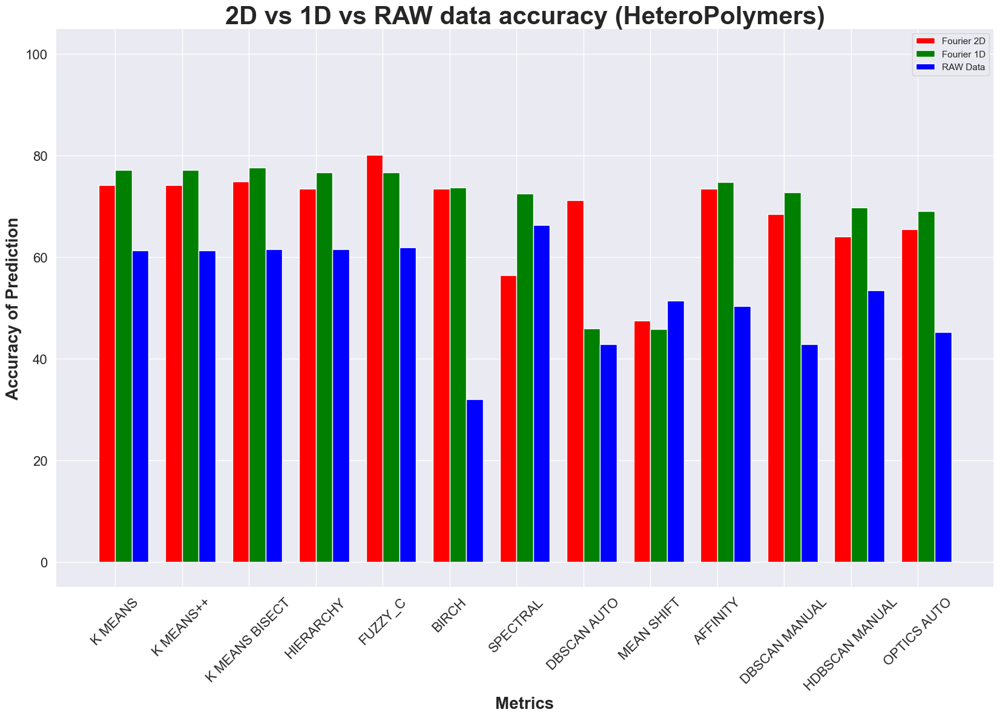

In [315]:

N = 13
ind = np.arange(N)
width = 0.25
fig = plt.figure(figsize=(20, 12), dpi = 100) # Size & DPI of Plot
xvals = DG_2
bar1 = plt.bar(ind, xvals, width, color = 'red')

yvals = DG_1
bar2 = plt.bar(ind+width, yvals, width, color='green')

zvals = DG_R
bar3 = plt.bar(ind+width*2, zvals, width, color = 'blue')
plt.xlabel("Metrics", fontweight = 'bold', fontsize = 20)
plt.ylabel("Accuracy of Prediction",fontweight='bold',fontsize = 20)
plt.title("2D vs 1D vs RAW data accuracy (HeteroPolymers)",fontweight='bold',fontsize = 30)

plt.xticks(ind + width/2, FULL_2D.index, rotation = 45, fontsize = 16)
plt.yticks(fontsize = 16)
plt.legend( (bar1, bar2, bar3), ('Fourier 2D', 'Fourier 1D', 'RAW Data') )
plt.ylim(-5,105)
plt.savefig("Accuracy Comparison",bbox_inches='tight')
plt.show()


In [15]:
IPLOT.plotter(original)

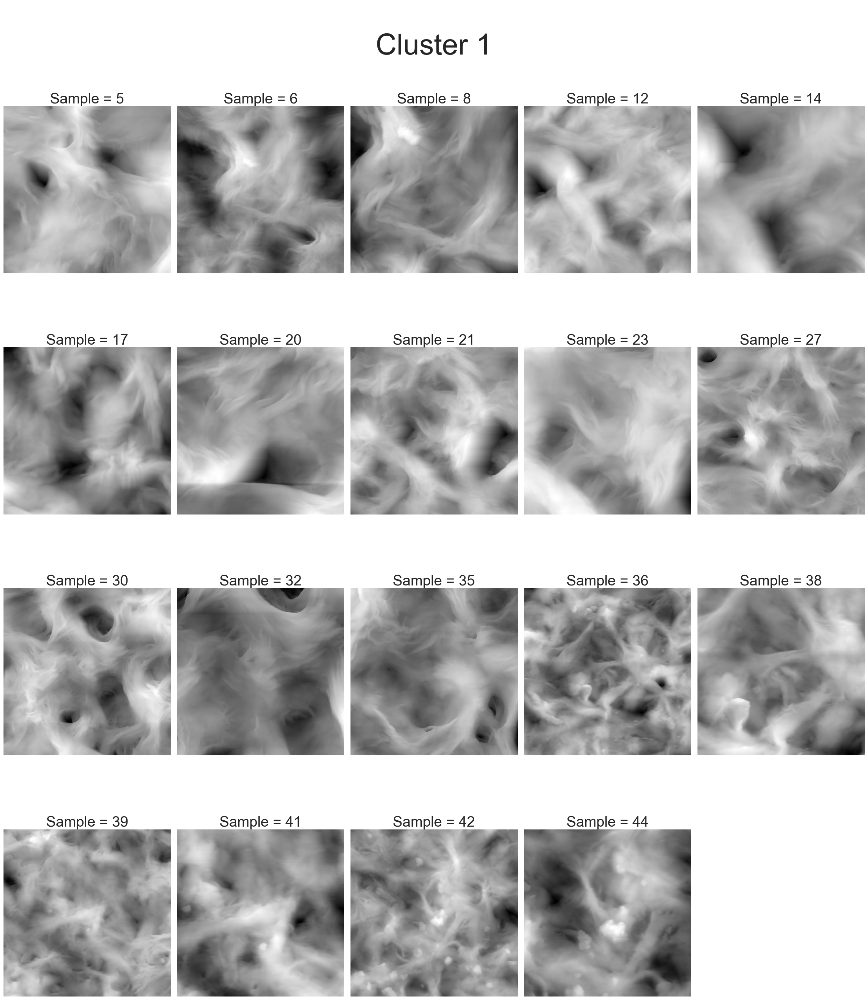

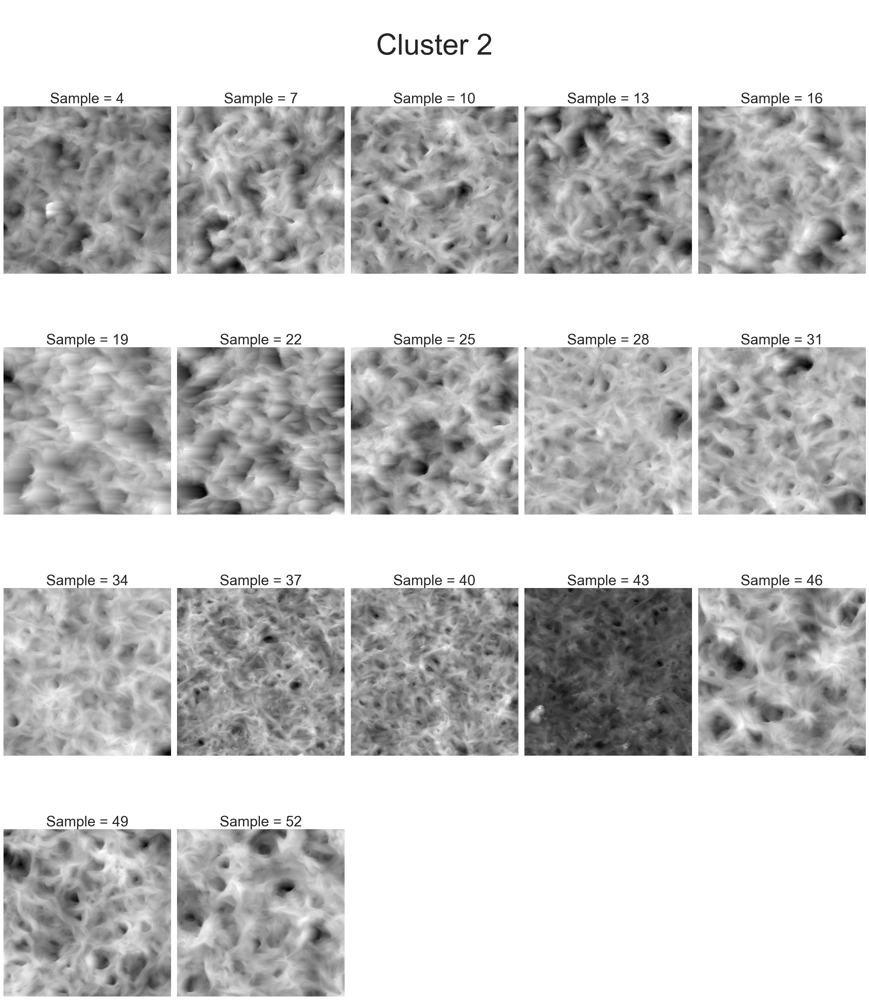

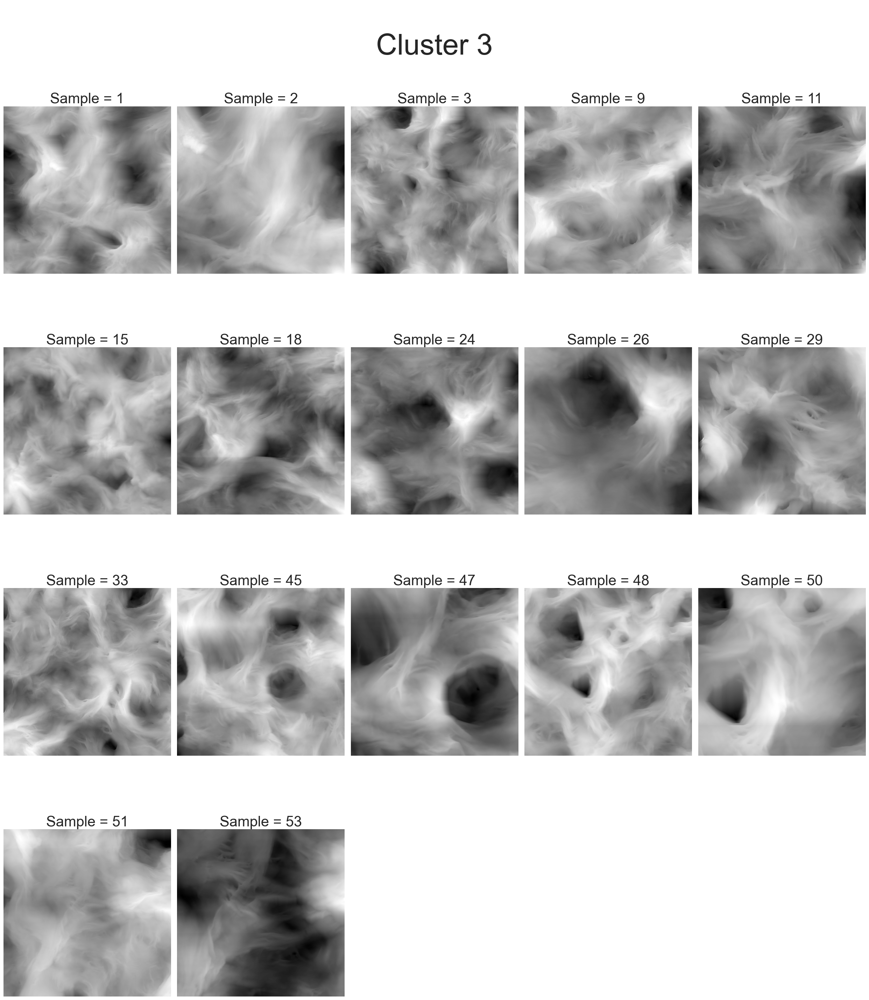

In [37]:
FPLOT.plotter_2(T2_A1_G1[0], original)